# Homework 5 - USA Airport Flight Analysis

In [6]:
import pandas as pd
from typing import Dict, Any, List, Tuple, Set
from collections import defaultdict
import dash
from dash import dcc, html, dash_table
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator, FuncFormatter
import io
import base64
import numpy as np

## EDA

We conducted an Exploratory Data Analysis to understand the structure of our data. We immediately noticed that there is **missing information** related to **latitude** and **longitude**. However, the data refer to specific flights and specific dates.
What we want to do is accurately identify unique airports that lack these coordinates. 
- We identified **243** airports
- Subsequently we queried an **API key** to retrieve the coordinates of these airports.

In [2]:
file_path = 'archive_usa_airport/Airports2.csv'
df = pd.read_csv(file_path)
df.isna().sum()

Origin_airport               0
Destination_airport          0
Origin_city                  0
Destination_city             0
Passengers                   0
Seats                        0
Flights                      0
Distance                     0
Fly_date                     0
Origin_population            0
Destination_population       0
Org_airport_lat           6954
Org_airport_long          6954
Dest_airport_lat          6807
Dest_airport_long         6807
dtype: int64

In [ ]:

def find_missing_coordinates(df: pd.DataFrame) -> Tuple[Set[Tuple[str, str]], int]:
    """
    Find the airports with missing data.
    """
    missing_org = df[(df['Org_airport_lat'].isna() & df['Org_airport_long'].isna())]
    missing_dest = df[(df['Dest_airport_lat'].isna() & df['Dest_airport_long'].isna())]

    unique_origin = set(zip(missing_org['Origin_airport'], missing_org['Origin_city']))
    unique_dest = set(zip(missing_dest['Destination_airport'], missing_dest['Destination_city']))

    unique_airports = unique_origin.union(unique_dest)
    return unique_airports, len(unique_airports)
unique_airports, missing_count = find_missing_coordinates(df)
print(f"Number of airports with missing coordinates: {missing_count}")




Number of airports with missing coordinates: 243


The airports with missing coordinates were identified and saved in a CSV file (`airports_without_coordinates.csv`).
This file was used as input to query the Open Cage API.
For each airport:
- A request was sent to the API providing the airport code or city.
- The API returned the corresponding coordinates (latitude and longitude).
- The obtained results extracted from the the `cage.py` file were saved in the file `airport_coordinates_.csv`.


In [ ]:
def export_missing_airports(airports: Set[Tuple[str, str]], output_file: str) -> None:
    """
    Export the missing airports to a CSV file. In order to fetch coordinates through API
    """
    df_missing = pd.DataFrame(list(airports), columns=['Airport Code', 'City'])
    df_missing.to_csv(output_file, index=False, sep=';')

export_missing_airports(unique_airports, 'archive_usa_airport/airports_without_coordinates.csv')



Subsequently, we use the dictionary **`airport_mapping`**, which associates each airport code with its corresponding coordinates. The dictionary was created the **`airport_coordinates_.csv`**file. It allows us to quickly look up the coordinates of an airport given its code (**`airport_code`**).  
The missing coordinates in the columns **`Org_airport_lat`**, **`Org_airport_long`**, **`Dest_airport_lat`**, and **`Dest_airport_long`** are filled using the **`airport_mapping`** dictionary.

In [ ]:

coordinates_file = 'archive_usa_airport/airport_coordinates_.csv'
coordinates_df = pd.read_csv(coordinates_file, sep=';')

def create_airport_mapping(coordinates_df: pd.DataFrame) -> Dict:
    """
    A mapping of airport codes to their corresponding coordinates.
    """
    return coordinates_df.set_index('airport_code')[['latitude', 'longitude']].to_dict(orient='index')

airport_mapping = create_airport_mapping(coordinates_df)

def fill_missing_coordinates(df: pd.DataFrame, airport_mapping: Dict) -> pd.DataFrame:


    df['Org_airport_lat'] = df['Org_airport_lat'].fillna(
        df['Origin_airport'].map(lambda x: airport_mapping.get(x, {}).get('latitude'))
    )
    df['Org_airport_long'] = df['Org_airport_long'].fillna(
        df['Origin_airport'].map(lambda x: airport_mapping.get(x, {}).get('longitude'))
    )

    df['Dest_airport_lat'] = df['Dest_airport_lat'].fillna(
        df['Destination_airport'].map(lambda x: airport_mapping.get(x, {}).get('latitude'))
    )
    df['Dest_airport_long'] = df['Dest_airport_long'].fillna(
        df['Destination_airport'].map(lambda x: airport_mapping.get(x, {}).get('longitude'))
    )

    return df


df_final = fill_missing_coordinates(df, airport_mapping)
df_final.isna().sum()

Origin_airport            0
Destination_airport       0
Origin_city               0
Destination_city          0
Passengers                0
Seats                     0
Flights                   0
Distance                  0
Fly_date                  0
Origin_population         0
Destination_population    0
Org_airport_lat           0
Org_airport_long          0
Dest_airport_lat          0
Dest_airport_long         0
dtype: int64

In [ ]:
df_final

,Origin_airport,Destination_airport,Origin_city,Destination_city,Passengers,Seats,Flights,Distance,Fly_date,Origin_population,Destination_population,Org_airport_lat,Org_airport_long,Dest_airport_lat,Dest_airport_long
0,MHK,AMW,"Manhattan, KS","Ames, IA",21,30,1,254,2008-10-01,122049,86219,39.140999,-96.670799,42.026757,-93.617045
1,EUG,RDM,"Eugene, OR","Bend, OR",41,396,22,103,1990-11-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
2,EUG,RDM,"Eugene, OR","Bend, OR",88,342,19,103,1990-12-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
3,EUG,RDM,"Eugene, OR","Bend, OR",11,72,4,103,1990-10-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
4,MFR,RDM,"Medford, OR","Bend, OR",0,18,1,156,1990-02-01,147300,76034,42.374199,-122.873001,44.254101,-121.150002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3606798,STL,TBN,"St. Louis, MO","Fort Leonard Wood, MO",281,969,51,119,2009-02-01,2828990,46457,38.748699,-90.370003,37.741600,-92.140701
3606799,STL,TBN,"St. Louis, MO","Fort Leonard Wood, MO",245,1026,54,119,2009-11-01,2828990,46457,38.748699,-90.370003,37.741600,-92.140701
3606800,STL,TBN,"St. Louis, MO","Fort Leonard Wood, MO",363,1273,67,119,2009-08-01,2828990,46457,38.748699,-90.370003,37.741600,-92.140701
3606801,CGI,TBN,"Cape Girardeau, MO","Fort Leonard Wood, MO",2,19,1,146,2009-08-01,93712,46457,37.225300,-89.570801,37.741600,-92.140701


## 1. Flight Network Analysis (Q1)

### 1.1 analyze_graph_feature


In this section we present the **`analyze_graph_features`** function, which integrates the following classes:

1. **`flight_network.py`**: This class constructs the USA flight network  as a directed graph, where each node represents an airport, and each directed edge represents a flight from one airport to another.

2. **`GraphAnalysis.py`**: This class analyze the network, calculate key metrics, and identify hubs. Specifically It computes : 
   - Number of Nodes and Edges.
   - Network Density.
   - Degree Metrics: both in-degree and out-degree for each airport.
   - key hubs in the network. The 90th percentile is used as threshold for identifying airports with the highest degree

In [ ]:
from auxiliary_files.flight_network import FlightNetwork
from auxiliary_files.GraphAnalysis import GraphAnalysis
from typing import Dict

def analyze_graph_features(network: FlightNetwork) -> Dict:
   
    
    graph_analysis = GraphAnalysis(network)

    
    n_nodes = network.graph.number_of_nodes()
    n_edges = network.graph.number_of_edges()
    density = graph_analysis.calculate_graph_density(n_nodes, n_edges)

   
    in_degrees, out_degrees = graph_analysis.get_degree_metrics()

    
    hubs = graph_analysis.identify_hub_airports()
    hubs_table = graph_analysis.create_hubs_table(hubs, in_degrees, out_degrees)

    return {
        'n_airports': n_nodes,
        'n_flights': n_edges,
        'density': density,
        'in_degrees': in_degrees,
        'out_degrees': out_degrees,
        'hubs_table': hubs_table,
    }




### 1.2 summarize_graph_features

Flight Network Analysis
Network Analysis Report:
- Number of Airports (Nodes): 727
- Number of Flights (Edges): 36719
- Graph Density: 0.1391

Top Hubs (Airports with highest degree)
Airport   In-degree   Out-degree  Total degree
----------------------------------------------
YIP       331         334         665         
MSP       291         292         583         
MEM       277         287         564         
ATL       259         280         539         
MCI       272         267         539         
ORD       240         286         526         
DFW       251         271         522         
STL       257         264         521         
IND       255         258         513         
MIA       236         269         505         
PHX       225         259         484         
IAD       230         251         481         
OKC       241         238         479         
LAS       227         247         474         
DTW       231         240         471         
SLC       219     

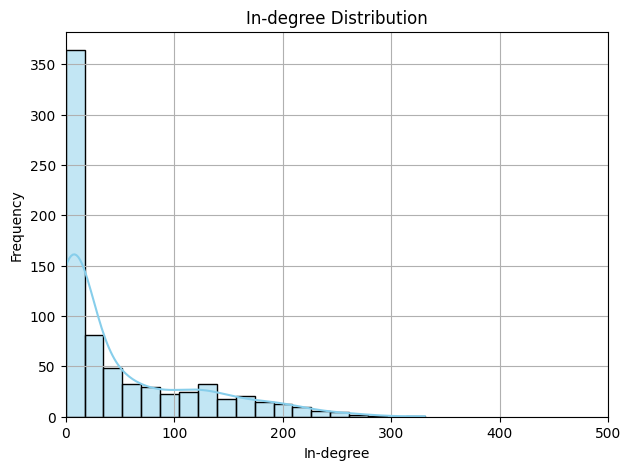

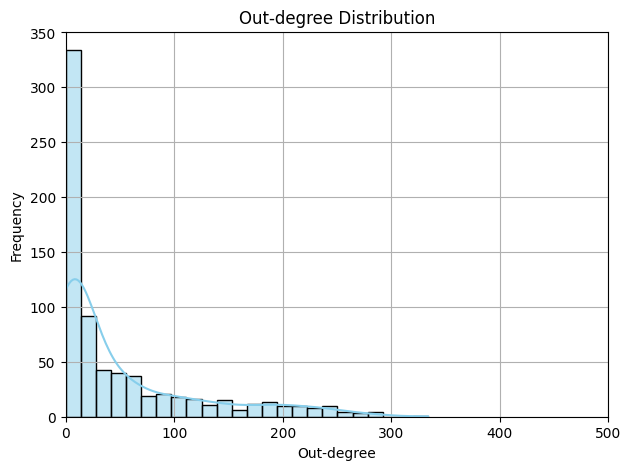

In [ ]:
flightnetwork = FlightNetwork()

origin_airports = df_final['Origin_airport']
destination_airports = df_final['Destination_airport']
distances=df["Distance"]

flightnetwork.add_nodes_and_edges(origin_airports, destination_airports, distances)
graph_analysis = GraphAnalysis(flightnetwork)

def print_flight_network_report_with_images(flightnetwork, graph_analysis):
    results = analyze_graph_features(flightnetwork)

    
    graph_analysis.get_image_from_figure(
        graph_analysis.plot_degree_distribution(list(results['in_degrees'].values()), "In-degree")
    )
    graph_analysis.get_image_from_figure(
        graph_analysis.plot_degree_distribution(list(results['out_degrees'].values()), "Out-degree")
    )

    
    summary_text = (
        "Flight Network Analysis\n"
        f"Network Analysis Report:\n"
        f"- Number of Airports (Nodes): {results['n_airports']}\n"
        f"- Number of Flights (Edges): {results['n_flights']}\n"
        f"- Graph Density: {results['density']:.4f}\n"
    )

    
    hubs_table_header = (
        "\nTop Hubs (Airports with highest degree)\n"
        f"{'Airport':<10}{'In-degree':<12}{'Out-degree':<12}{'Total degree':<12}\n"
        + "-" * 46
    )

    hubs_table_rows = "\n".join(
        f"{row['Airport']:<10}{row['In-degree']:<12}{row['Out-degree']:<12}{row['Total degree']:<12}"
        for row in results['hubs_table'].to_dict('records')
    )

    
    full_report = summary_text + hubs_table_header + "\n" + hubs_table_rows
    print(full_report)


print_flight_network_report_with_images(flightnetwork, graph_analysis)



## 1.3

Now let's dive deeper into the analysis of the dataset. Do the following:

- Compute total passenger flow between origin and destination cities. 
- Identify and visualize the busiest routes by passenger traffic.
- Calculate the average passengers per flight for each route and highlight under/over-utilized connections.
- Create an interactive map visualizing the geographic spread of the flight network.

### Compute total passenger flow between origin and destination cities.

In [ ]:

def compute_passenger_flow_cities(data):

    total_passenger_flow = data.groupby(['Origin_city', 'Destination_city'])['Passengers'].sum().reset_index()
    total_passenger_flow = total_passenger_flow.sort_values(by='Passengers', ascending=False)
    return total_passenger_flow

passenger_flow_cities = compute_passenger_flow_cities(df_final)
display(passenger_flow_cities)

,Origin_city,Destination_city,Passengers
7122,"Dallas, TX","Houston, TX",38295025
12391,"Houston, TX","Dallas, TX",37989016
13585,"Kahului, HI","Honolulu, HI",32364664
12259,"Honolulu, HI","Kahului, HI",29744742
16133,"Los Angeles, CA","Honolulu, HI",28964232
...,...,...,...
14206,"Klamath Falls, OR","Anchorage, AK",0
14218,"Klamath Falls, OR","Roseburg, OR",0
25915,"Seattle, WA","West Palm Beach, FL",0
14226,"Knoxville, TN","Albany, GA",0


### Identify and visualize the busiest routes by passenger traffic.

In [ ]:

top_flights = (
    df_final.groupby(['Origin_airport', 'Destination_airport', 'Org_airport_lat', 'Org_airport_long', 'Dest_airport_lat', 'Dest_airport_long'])
    .agg({'Passengers': 'sum', 'Flights': 'sum', 'Seats': 'sum'}) 
    .reset_index()
    .sort_values(by='Passengers', ascending=False)
)

In [ ]:



def plot_busiest_routes_airports(passenger_flow):
    
    passenger_flow['Route'] = passenger_flow['Origin_airport'] + " - " + passenger_flow['Destination_airport']

    
    top_routes = passenger_flow.sort_values(by='Passengers', ascending=False).head(45)

    
    plt.figure(figsize=(12, 8))

    
    norm = plt.Normalize(top_routes['Passengers'].min(), top_routes['Passengers'].max())
    sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
    sm.set_array([])

    
    sns.barplot(x='Passengers', y='Route', data=top_routes, palette="viridis", errorbar=None)


    
    plt.title('Busiest Routes by Passenger Traffic (Airports)', fontsize=14)
    plt.xlabel('Total Passengers', fontsize=12)
    plt.ylabel('Routes (Origin - Destination)', fontsize=12)
    plt.xticks(rotation=45)
    plt.gca().xaxis.set_major_locator(MaxNLocator(integer=True))  
    

    
    plt.legend([], frameon=False)

    
    plt.tight_layout()
    plt.savefig("busiest_routes_airportsv.png", format='png')
    
    
    
    plt.show()

In [ ]:

passenger_flow_airports = top_flights

display(passenger_flow_airports[['Origin_airport', 'Destination_airport', 'Passengers']])



,Origin_airport,Destination_airport,Passengers
25706,OGG,HNL,32364612
15625,HNL,OGG,29744742
19159,LAX,HNL,28964154
15606,HNL,LAX,28632161
18874,LAS,LAX,26333721
...,...,...,...
19487,LBL,PIA,0
19489,LBL,RFD,0
19491,LBL,SDM,0
19496,LBL,YIP,0


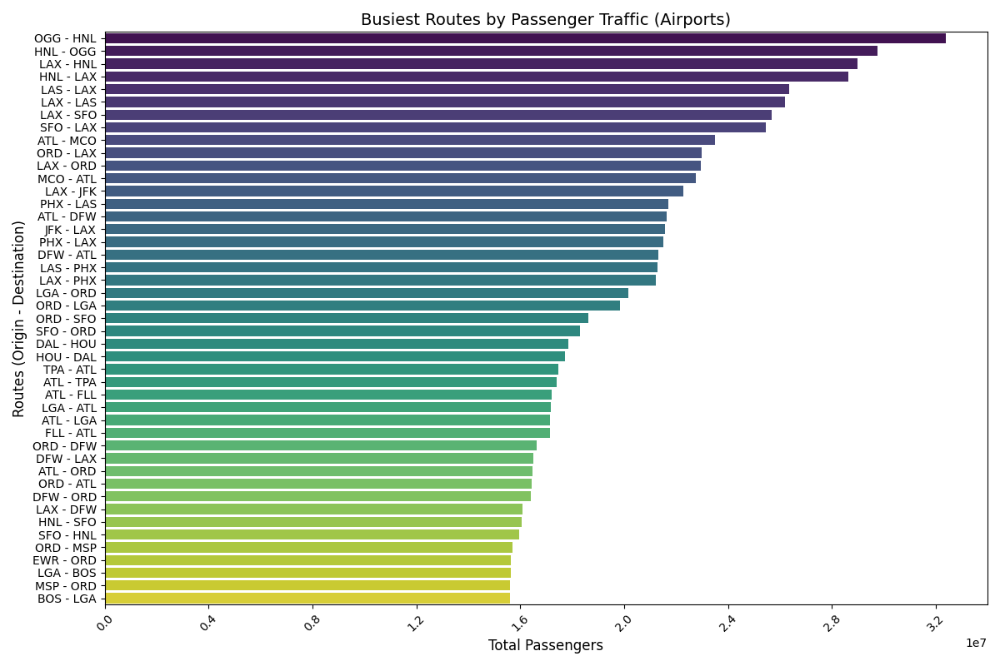

### Calculate the average passengers per flight for each route and highlight under/over-utilized connections.


To calculate the efficiency of flight routes and identify the routes with the highest passenger density per flight. Here's our steps:

1. **Filtering Rows**: We first kept only the rows where the number of **passengers** does not exceed the **total seat capacity** for that route. The total capacity is calculated by multiplying the number of **seats per flight** (`Seats`) by the number of **flights** (`Flights`). If the number of passengers exceeds the total capacity, the row was removed since they could represents **overbooking** issues.

2. **Total Capacity**: We then calculated the **total seat capacity** for each route by multiplying the number of **seats per flight** by the number of **flights**.

3. **Efficiency**: The efficiency for each route was calculated as the ratio of **passengers** to **total seat capacity**.

4. **Passengers per Flight**: We also calculated the average **passengers per flight** by dividing the number of **passengers** by the number of **flights**. This gives an idea of how much of the flight's capacity is being utilized per flight.

We display the routes with the highest number of **flights** and the highest **passenger density per flight** 

**The San Francisco International Airport (SFO) and Los Angeles International Airport (LAX) stand out as the most significant airports in terms of the number of flights and passengers per flight.** These airports emerge as the most important, not only for the number of flights operated but also for the high number of passengers per flight, reflecting the strong demand for air travel between these two cities.

In [ ]:
import numpy as np
import pandas as pd
import numpy as np
import pandas as pd

def passangerperflight(df_final):
    
    df_final = df_final[df_final['Passengers'] <= df_final['Seats'] * df_final['Flights']].copy()  
    df_final.loc[:, 'Total_Seats'] = df_final['Seats'] * df_final['Flights']  
    
    
    df_final.loc[:, 'Efficiency'] = np.where(
        df_final['Total_Seats'] == 0,
        0,  
        np.minimum(df_final['Passengers'] / df_final['Total_Seats'], 1)  
    )
    
    
    df_final.loc[:, 'Passengers_per_Flight'] = np.where(
        df_final['Flights'] == 0,  # 
        0, 
        df_final['Passengers'] / df_final['Flights']
    )
    
    
    df_final_sorted = df_final.sort_values(by=['Flights','Passengers_per_Flight','Efficiency'], ascending=[False, False,False])
    
    
    df_final_sorted.loc[:, 'Route'] = df_final_sorted['Origin_airport'] + " - " + df_final_sorted['Destination_airport']
    
    return df_final_sorted


sorted_df = passangerperflight(df_final)
display(sorted_df)



,Origin_airport,Destination_airport,Origin_city,Destination_city,Passengers,Seats,Flights,Distance,Fly_date,Origin_population,Destination_population,Org_airport_lat,Org_airport_long,Dest_airport_lat,Dest_airport_long,Total_Seats,Efficiency,Passengers_per_Flight,Route
2975875,SFO,LAX,"San Francisco, CA","Los Angeles, CA",83153,142128,1128,337,1994-12-01,7666396,23179000,37.618999,-122.375000,33.942501,-118.407997,160320384,0.000519,73.717199,SFO - LAX
3438039,LAX,SFO,"Los Angeles, CA","San Francisco, CA",80450,141876,1126,337,1994-12-01,23179000,7666396,33.942501,-118.407997,37.618999,-122.375000,159752376,0.000504,71.447602,LAX - SFO
1153503,HNL,OGG,"Honolulu, HI","Kahului, HI",73014,147062,1058,100,1994-08-01,869959,112610,21.318701,-157.921997,20.898600,-156.429993,155591596,0.000469,69.011342,HNL - OGG
1643395,OGG,HNL,"Kahului, HI","Honolulu, HI",77011,146784,1056,100,1994-08-01,112610,869959,20.898600,-156.429993,21.318701,-157.921997,155003904,0.000497,72.927083,OGG - HNL
2980169,SFO,LAX,"San Francisco, CA","Los Angeles, CA",77531,131544,1044,337,1995-01-01,7704224,23203726,37.618999,-122.375000,33.942501,-118.407997,137331936,0.000565,74.263410,SFO - LAX
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3602551,CVG,COS,"Cincinnati, OH","Colorado Springs, CO",0,0,0,1078,2002-12-01,2050030,566091,39.048801,-84.667801,38.805801,-104.700996,0,0.000000,0.000000,CVG - COS
3602586,ORD,COS,"Chicago, IL","Colorado Springs, CO",0,0,0,911,2002-01-01,18490270,566091,41.978600,-87.904800,38.805801,-104.700996,0,0.000000,0.000000,ORD - COS
3603050,CVG,COS,"Cincinnati, OH","Colorado Springs, CO",0,0,0,1078,2003-08-01,2066256,572399,39.048801,-84.667801,38.805801,-104.700996,0,0.000000,0.000000,CVG - COS
3603057,CVG,COS,"Cincinnati, OH","Colorado Springs, CO",0,0,0,1078,2003-02-01,2066256,572399,39.048801,-84.667801,38.805801,-104.700996,0,0.000000,0.000000,CVG - COS


Among the flights with the highest efficiency, we can highlight those with a high number of passengers. In other words, we focus on flights that not only make optimal use of available seats (high efficiency) but also carry a significant number of passengers.

In [ ]:
def passangerperflight(df_final):
    
    df_final = df_final[df_final['Passengers'] <= df_final['Seats'] * df_final['Flights']].copy()  
    df_final.loc[:, 'Total_Seats'] = df_final['Seats'] * df_final['Flights']  
    
    
    df_final.loc[:, 'Efficiency'] = np.where(
        df_final['Total_Seats'] == 0,
        0,  
        np.minimum(df_final['Passengers'] / df_final['Total_Seats'], 1)  
    )
    
    
    df_final.loc[:, 'Passengers_per_Flight'] = np.where(
        df_final['Flights'] == 0,  
        0, 
        df_final['Passengers'] / df_final['Flights']
    )
    
    
    df_final_sorted = df_final.sort_values(by=['Efficiency','Flights','Passengers_per_Flight'], ascending=[False, False,False])
    
    
    df_final_sorted.loc[:, 'Route'] = df_final_sorted['Origin_airport'] + " - " + df_final_sorted['Destination_airport']
    
    return df_final_sorted


sorted_df = passangerperflight(df_final)
display(sorted_df)





,Origin_airport,Destination_airport,Origin_city,Destination_city,Passengers,Seats,Flights,Distance,Fly_date,Origin_population,Destination_population,Org_airport_lat,Org_airport_long,Dest_airport_lat,Dest_airport_long,Total_Seats,Efficiency,Passengers_per_Flight,Route
2989778,OAK,LAX,"Oakland, CA","Los Angeles, CA",534,534,1,337,1998-06-01,3998233,23895178,37.721298,-122.221001,33.942501,-118.407997,534,1.0,534.0,OAK - LAX
1340834,MCO,SFB,"Orlando, FL","Orlando, FL",517,517,1,24,2007-07-01,2034878,2034878,28.429399,-81.308998,28.777599,-81.237503,517,1.0,517.0,MCO - SFB
3426707,ANC,SFO,"Anchorage, AK","San Francisco, CA",494,494,1,2018,1991-07-01,277177,7498756,61.174400,-149.996002,37.618999,-122.375000,494,1.0,494.0,ANC - SFO
3426967,ANC,SFO,"Anchorage, AK","San Francisco, CA",494,494,1,2018,1991-08-01,277177,7498756,61.174400,-149.996002,37.618999,-122.375000,494,1.0,494.0,ANC - SFO
1701095,SFO,JFK,"San Francisco, CA","New York, NY",493,493,1,2586,1996-04-01,7772198,34380072,37.618999,-122.375000,40.639801,-73.778900,493,1.0,493.0,SFO - JFK
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3602551,CVG,COS,"Cincinnati, OH","Colorado Springs, CO",0,0,0,1078,2002-12-01,2050030,566091,39.048801,-84.667801,38.805801,-104.700996,0,0.0,0.0,CVG - COS
3602586,ORD,COS,"Chicago, IL","Colorado Springs, CO",0,0,0,911,2002-01-01,18490270,566091,41.978600,-87.904800,38.805801,-104.700996,0,0.0,0.0,ORD - COS
3603050,CVG,COS,"Cincinnati, OH","Colorado Springs, CO",0,0,0,1078,2003-08-01,2066256,572399,39.048801,-84.667801,38.805801,-104.700996,0,0.0,0.0,CVG - COS
3603057,CVG,COS,"Cincinnati, OH","Colorado Springs, CO",0,0,0,1078,2003-02-01,2066256,572399,39.048801,-84.667801,38.805801,-104.700996,0,0.0,0.0,CVG - COS


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MaxNLocator

def plot_busiest_routes_efficiency(df_final):
    
    df_final = passangerperflight(df_final)

    
    top_routes = df_final.sort_values(by='Efficiency', ascending=False).head(45)

    
    plt.figure(figsize=(12, 8))

    
    norm = plt.Normalize(top_routes['Efficiency'].min(), top_routes['Efficiency'].max())
    sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
    sm.set_array([])

    
    sns.barplot(x='Efficiency', y='Route', data=top_routes, palette="viridis", errorbar=None)

   
    plt.title('Busiest Routes by Efficiency (Airports)', fontsize=14)
    plt.xlabel('Efficiency', fontsize=12)  
    plt.ylabel('Routes (Origin - Destination)', fontsize=12)
    plt.xticks(rotation=45)
    plt.gca().xaxis.set_major_locator(MaxNLocator(integer=True))  

    
    plt.legend([], frameon=False)

    
    plt.tight_layout()
    plt.savefig("busiest_routes_efficiency.png", format='png')

    
    plt.show()

plot_busiest_routes_efficiency(df_final)



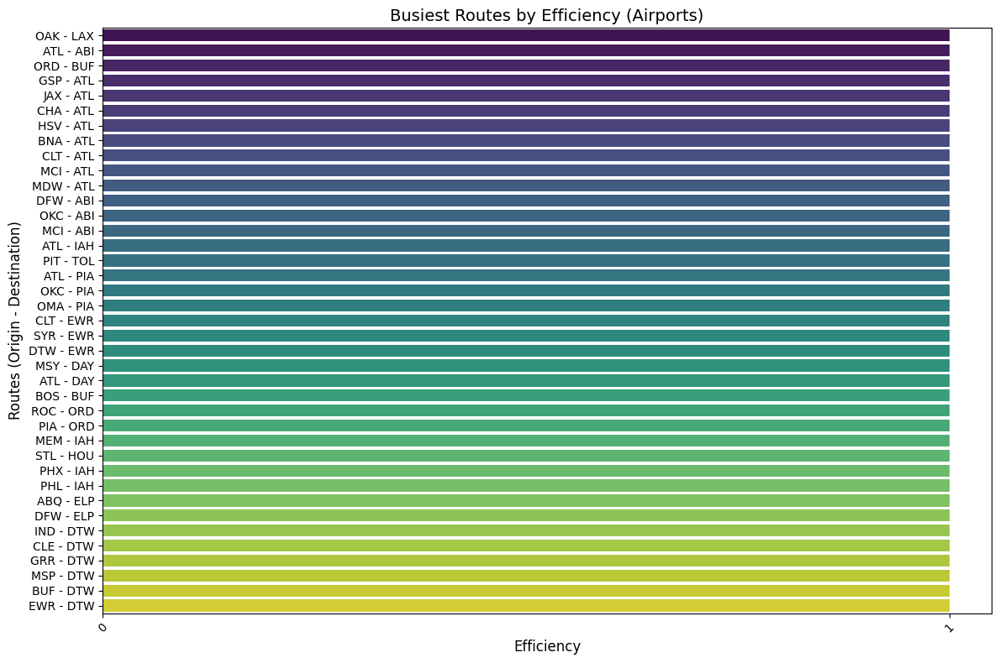


**under/over-utilized connections**

- We are visualizing the most heavily utilized flights in terms of passenger traffic while also showcasing their seat efficiency. To provide clarity, we’ve plotted the top flights by passenger numbers on a map. In the visualization, passenger efficiency is depicted.The density of the nodes represents the average number of passengers per flight.

- Additionally, we’ve highlighted flights with zero passengers. One interesting observation is the airport code ILN, which belongs to a cargo airport. While it is heavily used for commercial purposes, it does not accommodate passengers, explaining the lack of passenger traffic on its routes.

In [ ]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
import seaborn as sns

def calculate_efficiency(df):
    df['Total_Seats'] = df['Seats'] * df['Flights']
    df['Efficiency'] = np.where(
        df['Total_Seats'] == 0,
        0,
        np.minimum(df['Passengers'] / df['Total_Seats'], 1)
    )
    return df


def remove_bidirectional_duplicates(data):
    seen = set()
    unique_routes = []
    for _, row in data.iterrows():
        route = tuple(sorted([row['Origin_airport'], row['Destination_airport']]))
        if route not in seen:
            seen.add(route)
            unique_routes.append(row)
    return pd.DataFrame(unique_routes)


def plot_top_flights(df, top_n=30):
    
    top_flights = (
        df.groupby(['Origin_airport', 'Destination_airport', 'Org_airport_lat', 'Org_airport_long',
                    'Dest_airport_lat', 'Dest_airport_long'])
        .agg({'Passengers': 'sum', 'Flights': 'sum', 'Seats': 'sum', 'Efficiency': 'mean'})
        .reset_index()
        .sort_values(by='Passengers', ascending=False)
    )

    
    top_flights['Passengers_per_Flight'] = top_flights['Passengers'] / top_flights['Flights']

    
    top_flights = remove_bidirectional_duplicates(top_flights.head(top_n))

    
    palette = sns.color_palette("husl", 8)

   
    fig = go.Figure()

    
    fig.add_trace(
        go.Scattergeo(
            lon=top_flights['Org_airport_long'],
            lat=top_flights['Org_airport_lat'],
            text=top_flights.apply(
                lambda row: f"{row['Origin_airport']}<br>{row['Passengers_per_Flight']:.1f} Passengers per Flight<br>Seat Efficiency: {row['Efficiency']:.2f}", axis=1
            ),
            mode='markers',
            marker=dict(
                size=top_flights['Passengers_per_Flight'],
                color='blue',
                sizeref=max(top_flights['Passengers_per_Flight']) / 30,
                sizemode='diameter'
            ),
            name='Origin Airports'
        )
    )

    
    fig.add_trace(
        go.Scattergeo(
            lon=top_flights['Dest_airport_long'],
            lat=top_flights['Dest_airport_lat'],
            text=top_flights.apply(
                lambda row: f"{row['Destination_airport']}<br>{row['Passengers_per_Flight']:.1f} Passengers per Flight<br>Seat Efficiency: {row['Efficiency']:.2f}", axis=1
            ),
            mode='markers',
            marker=dict(
                size=top_flights['Passengers_per_Flight'],
                color='red',
                sizeref=max(top_flights['Passengers_per_Flight']) / 30,
                sizemode='diameter'
            ),
            name='Destination Airports'
        )
    )

    
    for idx, row in top_flights.iterrows():
        color = f'rgb({int(palette[idx % 8][0] * 255)}, {int(palette[idx % 8][1] * 255)}, {int(palette[idx % 8][2] * 255)})'
        fig.add_trace(
            go.Scattergeo(
                lon=[row['Org_airport_long'], row['Dest_airport_long']],
                lat=[row['Org_airport_lat'], row['Dest_airport_lat']],
                mode='lines',
                line=dict(width=2, color=color),
                opacity=0.7,
                name=f"{row['Origin_airport']} to {row['Destination_airport']}"
            )
        )

    
    fig.update_layout(
        title_text=f'Top {top_n} Flights (Passengers per Flight and Seat Efficiency)',
        showlegend=True,
        geo=dict(
            scope='usa',
            showland=True,
            landcolor='rgb(217, 217, 217)',
            projection_type='albers usa',
            coastlinecolor="Black",
            showcoastlines=True
        )
    )
    return fig


def plot_bottom_flights(df, bottom_n=15):
    
    bottom_flights = (
        df.groupby(['Origin_airport', 'Destination_airport', 'Org_airport_lat', 'Org_airport_long',
                    'Dest_airport_lat', 'Dest_airport_long'])
        .agg({'Passengers': 'sum', 'Flights': 'sum', 'Seats': 'sum', 'Efficiency': 'mean'})
        .reset_index()
        .sort_values(by='Passengers', ascending=True)
    )

    
    bottom_flights = remove_bidirectional_duplicates(bottom_flights.head(bottom_n))

    
    palette = sns.color_palette("hls", 8)

    
    fig = go.Figure()

    
    fig.add_trace(
        go.Scattergeo(
            lon=bottom_flights['Org_airport_long'],
            lat=bottom_flights['Org_airport_lat'],
            text=bottom_flights.apply(
                lambda row: f"{row['Origin_airport']}<br>{row['Passengers'] / 1e6:.1f} million Passengers<br>Efficiency: {row['Efficiency']:.2f}", axis=1
            ),
            mode='markers',
            marker=dict(size=10, color='blue'),
            name='Origin Airports'
        )
    )

   
    fig.add_trace(
        go.Scattergeo(
            lon=bottom_flights['Dest_airport_long'],
            lat=bottom_flights['Dest_airport_lat'],
            text=bottom_flights.apply(
                lambda row: f"{row['Destination_airport']}<br>{row['Passengers'] / 1e6:.1f} million Passengers<br>Efficiency: {row['Efficiency']:.2f}", axis=1
            ),
            mode='markers',
            marker=dict(size=10, color='red'),
            name='Destination Airports'
        )
    )

   
    for idx, row in bottom_flights.iterrows():
        color = f'rgb({int(palette[idx % 8][0] * 255)}, {int(palette[idx % 8][1] * 255)}, {int(palette[idx % 8][2] * 255)})'
        fig.add_trace(
            go.Scattergeo(
                lon=[row['Org_airport_long'], row['Dest_airport_long']],
                lat=[row['Org_airport_lat'], row['Dest_airport_lat']],
                mode='lines',
                line=dict(width=2, color=color),
                opacity=0.7,
                name=f"{row['Origin_airport']} to {row['Destination_airport']}"
            )
        )

    # Layout
    fig.update_layout(
        title_text=f'Bottom {bottom_n} Flights (In Terms of Passengers)',
        showlegend=True,
        geo=dict(
            scope='usa',
            showland=True,
            landcolor='rgb(217, 217, 217)',
            projection_type='albers usa',
            coastlinecolor="Black",
            showcoastlines=True
        )
    )
    return fig

top_fig = plot_top_flights(df, top_n=30)
bottom_fig = plot_bottom_flights(df, bottom_n=30)


top_fig.show()
bottom_fig.show()


[top flights](images/top_flights.html)

[bottom flights](images/bottom_flights.html)

### REPORT

**Is the graph sparse or dense?** 

With respect to the maximum possible number of edges. Our graph has 0.06 as density value.This suggests that most of the possible edges are missing. Therefore, the graph is considered sparse.


**What patterns do you observe in the degree distribution?** 

For both in-degree and out-degree, we observe the same pattern: there are many airports with a low number of connections and a few airports with a very high number of edges. These high-degree airports act as hubs, which can be seen in the bottom-right part of the graph, where the airports with the most connections are clustered together. 



In [ ]:
import matplotlib.pyplot as plt

results = analyze_graph_features(flightnetwork)

in_degree_figure = graph_analysis.plot_degree_distribution(list(results['in_degrees'].values()), "In-degree")
out_degree_figure = graph_analysis.plot_degree_distribution(list(results['out_degrees'].values()), "Out-degree")


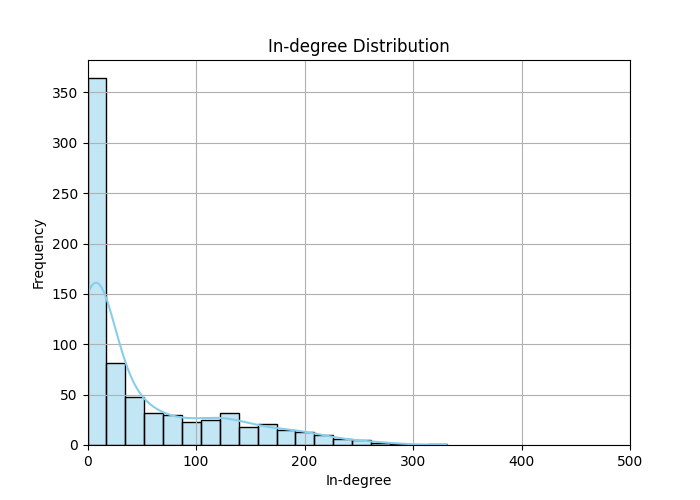
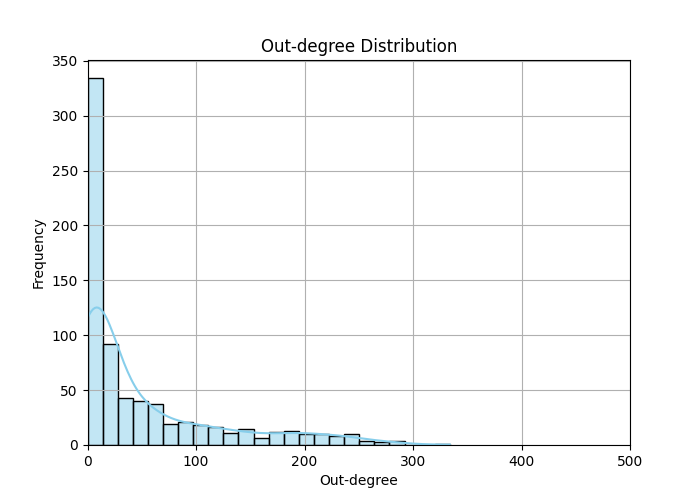

 **Which airports are identified as hubs, and why?** 

The hubs in our specific case are defined as the top 10% of airports based on their number of connections (total degree). These airports stand out for their high connectivity to other nodes in the network. From the graphical representation is possible to see that: 
- Many high-degree airports are located on the **East Coast** of the **United States**. 
- Airports in densely populated cities, such as **New York**, are major hubs due to high passenger and cargo traffic. such as **EWR** and **JFK**. 
- For example, **MEM** (Memphis International Airport) is identified as a hub. It is the second-busiest airport in the United States for cargo traffic, serving as a major logistics center. Similarly, airports like **MSP** (Minneapolis–Saint Paul International Airport) serve both as cargo hubs and significant commercial transportation centers. 

In [ ]:
from auxiliary_files.flight_network import FlightNetwork
from auxiliary_files.GraphAnalysis import GraphAnalysis
import pandas as pd
import plotly.express as px
from typing import Dict

graph_features = analyze_graph_features(flightnetwork)


in_degrees = graph_features['in_degrees']
out_degrees = graph_features['out_degrees']


all_airports = set(in_degrees.keys()).union(set(out_degrees.keys()))
total_degrees = {airport: in_degrees.get(airport, 0) + out_degrees.get(airport, 0) for airport in all_airports}

df_degrees = pd.DataFrame({
    'Origin_airport': list(total_degrees.keys()),
    'Total_degree': list(total_degrees.values())
})

df_final = df_final.drop_duplicates(subset='Origin_airport') 
df_final = df_final.merge(df_degrees, on='Origin_airport', how='left')


px.set_mapbox_access_token('your_mapbox_access_token') 

fig = px.scatter_mapbox(df_final,
                        lat='Org_airport_lat', 
                        lon='Org_airport_long',
                        size='Total_degree',  
                        color='Total_degree',  
                        hover_name='Origin_airport',
                        size_max=35,
                        title='Origin Airports by Total Degree',
                        template='plotly',
                        color_continuous_scale=px.colors.sequential.Viridis,
                        opacity=0.5)

fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_zoom=3,
    mapbox_center={"lat": df_final['Org_airport_lat'].mean(),
                   "lon": df_final['Org_airport_long'].mean()},
    showlegend=True
)


fig.show()


[hub_densitymap](images/hub_mapbox.html)


**What are the busiest routes in terms of passenger traffic?**

Busiest Routes in Terms of Passenger Traffic The busiest routes in terms of passenger traffic include: 
- OGG (Kahului, Hawaii)-- HNL (Kahului, Hawaii) 
- HNL (Honolulu, Hawaii) -- OGG (Kahului, Hawaii)-- 
- LAX (Los Angeles, California) -- HNL (Honolulu, Hawaii) 
- HNL (Honolulu, Hawaii) -- LAX (Los Angeles, California) 
- LAS (Las Vegas, Nevada) -- LAX (Los Angeles, California) 

This is clearly influenced by two key factors: 
1. The high population density of the cities hosting these airports, such as Los Angeles. 
2. The high tourist demand for destinations like Hawaii (Honolulu and Kahului) and Las Vegas, which are major vacation and leisure hubs


**Map**

We created a map that visually represents some of the flights, we'll color the nodes (airports) differently depending on whether they are the origin or the destination airport. Specifically, the origin airports will be colored green, the destination airports will be colored red, and the flight routes (lines) between the airports will be colored gray.

- <span style="color: green;">Origin Airports</span>
- <span style="color: red;">Destination Airports</span>
- <span style="color: Edges;">Edges </span>





In [ ]:
import pandas as pd
import random
from datetime import datetime


import folium

def plot_flights_on_map(df_final, top_n=30):
    
    top_flights = (
        df_final.groupby(['Origin_airport', 'Destination_airport', 'Org_airport_lat', 'Org_airport_long',
                          'Dest_airport_lat', 'Dest_airport_long'])
        .agg({'Passengers': 'sum', 'Flights': 'sum', 'Seats': 'sum'})
        .reset_index()
        .sort_values(by='Passengers', ascending=False)
    )

    
   
    top_flights['Passengers_per_Flight'] = np.where(
        top_flights['Flights'] == 0, 0, top_flights['Passengers'] / top_flights['Flights']
    )

    top_flights['Seat_Efficiency'] = np.where(
        top_flights['Seats'] == 0, 0, top_flights['Passengers'] / top_flights['Seats']
    )

    
    def remove_bidirectional_duplicates(data):
        seen = set()
        unique_routes = []
        for _, row in data.iterrows():
            route = tuple(sorted([row['Origin_airport'], row['Destination_airport']]))
            if route not in seen:
                seen.add(route)
                unique_routes.append(row)
        return pd.DataFrame(unique_routes)

    top_flights = remove_bidirectional_duplicates(top_flights.head(top_n))

    
    m = folium.Map(location=[39.8283, -98.5795], zoom_start=5)

    
    for idx, row in top_flights.iterrows():
        origin_marker = folium.CircleMarker(
            location=[row['Org_airport_lat'], row['Org_airport_long']],
            radius=8,
            color='green',
            fill=True,
            fill_color='green',
            fill_opacity=0.6,
            popup=f"Origin: {row['Origin_airport']}<br>Passengers per Flight: {row['Passengers_per_Flight']:.1f}<br>Seat Efficiency: {row['Seat_Efficiency']:.2f}"
        ).add_to(m)

        destination_marker = folium.CircleMarker(
            location=[row['Dest_airport_lat'], row['Dest_airport_long']],
            radius=8,
            color='red',
            fill=True,
            fill_color='red',
            fill_opacity=0.6,
            popup=f"Destination: {row['Destination_airport']}<br>Passengers per Flight: {row['Passengers_per_Flight']:.1f}<br>Seat Efficiency: {row['Seat_Efficiency']:.2f}"
        ).add_to(m)

        
        folium.PolyLine(
            locations=[(row['Org_airport_lat'], row['Org_airport_long']), 
                       (row['Dest_airport_lat'], row['Dest_airport_long'])],
            color='grey', weight=2, opacity=0.6
        ).add_to(m)

    
    return m

flight_map = plot_flights_on_map(df_final, top_n=5000)

flight_map


[flight_network_map](images/flight_network_map.html)

## 2. Nodes' Contribution (Q2)

### 2.1 

Implement a function analyze_centrality(flight_network, airport) that computes the following centrality measures for a given airport:

    Betweenness centrality: Measures how often a node appears on the shortest paths between other nodes.
    Closeness centrality: Measures how easily a node can access all other nodes in the network.
    Degree centrality: Simply counts the number of direct connections to the node.
    PageRank: Computes the "importance" of a node based on incoming connections and their weights.



In [3]:
flights = pd.read_csv('archive_usa_airport/flights_final.csv')

In [4]:
flights

,Origin_airport,Destination_airport,Origin_city,Destination_city,Passengers,Seats,Flights,Distance,Fly_date,Origin_population,Destination_population,Org_airport_lat,Org_airport_long,Dest_airport_lat,Dest_airport_long
0,MHK,AMW,"Manhattan, KS","Ames, IA",21,30,1,254,2008-10-01,122049,86219,39.140999,-96.670799,42.026757,-93.617045
1,EUG,RDM,"Eugene, OR","Bend, OR",41,396,22,103,1990-11-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
2,EUG,RDM,"Eugene, OR","Bend, OR",88,342,19,103,1990-12-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
3,EUG,RDM,"Eugene, OR","Bend, OR",11,72,4,103,1990-10-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
4,MFR,RDM,"Medford, OR","Bend, OR",0,18,1,156,1990-02-01,147300,76034,42.374199,-122.873001,44.254101,-121.150002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3606798,STL,TBN,"St. Louis, MO","Fort Leonard Wood, MO",281,969,51,119,2009-02-01,2828990,46457,38.748699,-90.370003,37.741600,-92.140701
3606799,STL,TBN,"St. Louis, MO","Fort Leonard Wood, MO",245,1026,54,119,2009-11-01,2828990,46457,38.748699,-90.370003,37.741600,-92.140701
3606800,STL,TBN,"St. Louis, MO","Fort Leonard Wood, MO",363,1273,67,119,2009-08-01,2828990,46457,38.748699,-90.370003,37.741600,-92.140701
3606801,CGI,TBN,"Cape Girardeau, MO","Fort Leonard Wood, MO",2,19,1,146,2009-08-01,93712,46457,37.225300,-89.570801,37.741600,-92.140701


In [5]:
from auxiliary_files.flight_network import FlightNetwork
flightnetwork = FlightNetwork()
flightnetwork.add_nodes_and_edges(flights['Origin_airport'], flights['Destination_airport'],distances=flights['Distance'])

### <strong> Function Explanation: get_all_shortest_path </strong>

The get_all_shortest_path function calculates the shortest paths and distances between all pairs of nodes in a flight network graph using Dijkstra's algorithm.
How It Works:

    For Each Source Node:
        Initializes distances (set to infinity for all nodes except the source) and paths (starting with the source node).
        Uses a priority queue to explore the graph and find the shortest path to each destination node.
        Updates the shortest distance and path for each node if a shorter route is found.

    Results:
        Stores the results for each source node in a dictionary:
            distances: Shortest distances to all other nodes.
            paths: The actual shortest paths as lists of nodes.

    Save to Object:
        At the end, the computed shortest paths are saved as an attribute (self.all_shortest_path) of the flight network object for future use.

In [ ]:
flightnetwork.get_all_shortest_path()

# Function Explanation: analyze_centrality

The analyze_centrality function computes centrality measures for a given airport $ a $ in a flight network graph $ G = (V, E) $, where $ V $ is the set of airports (nodes) and $ E $ is the set of direct flights (edges). These centrality measures quantify the importance of the airport within the network.

---

### Centrality Measures:

1. **Betweenness Centrality ($ C_B(a) $)**:
   $
   C_B(a) = \frac{1}{(n-1)(n-2)} \sum_{s \neq a \neq t \in V} \frac{\sigma_{st}(a)}{\sigma_{st}}
   $
   - $ \sigma_{st} $: Total number of shortest paths between nodes $ s $ and $ t $.
   - $ \sigma_{st}(a) $: Number of those paths that pass through $ a $.
   - $ n $: Total number of nodes ($ |V| $).
   - The normalization factor $ (n-1)(n-2) $ accounts for all possible source-destination pairs, excluding $ a $.

2. **Closeness Centrality ($ C_C(a) $)**:
   $
   C_C(a) = \frac{n-1}{\sum_{v \in V, v \neq a} d(a, v)}
   $
   - $ d(a, v) $: Shortest distance between $ a $ and $ v $.
   - $ n-1 $: Normalization factor for the number of other nodes.

   If $ \sum_{v \in V, v \neq a} d(a, v) = 0 $, then $ C_C(a) = 0 $.

3. **Degree Centrality ($ C_D(a) $)**:
   $
   C_D(a) = \frac{\deg(a)}{n-1}
   $
   - $ \deg(a) $: Number of outgoing edges (successors) from $ a $.
   - $ n-1 $: Total number of possible connections for $ a $.

4. **PageRank ($ PR(a) $)**:
   $
   PR(a) = (1 - \alpha) \frac{1}{n} + \alpha \sum_{b \in \text{Predecessors}(a)} \frac{PR(b)}{\deg^+(b)}
   $
   - $ \alpha $: Damping factor (default $ \alpha = 0.85 $).
   - $ \deg^+(b) $: Out-degree of node $ b $.
   - Computed iteratively over $ t $ iterations, initialized as $ PR(a) = \frac{1}{n} $ for all $ a \in V $.

---

### Results:
The function outputs a dictionary:
$
\text{centrality\_measures} = \{
    C_B(a): \text{betweenness centrality},
    C_C(a): \text{closeness centrality},
    C_D(a): \text{degree centrality},
    PR(a): \text{PageRank}
\}
$



In [8]:
flightnetwork.analyze_centrality('JFK')

{'betweenness_centrality': 0.007023843450175739,
 'closeness_centrality': 0.0008531601003109451,
 'degree_centrality': 0.3209366391184573,
 'pagerank': 0.004548312667078072}

The same can be done to compare centralities by just calling the same function to all the airports.

  0%|          | 0/727 [00:00<?, ?it/s]

100%|██████████| 727/727 [46:26<00:00,  3.83s/it]


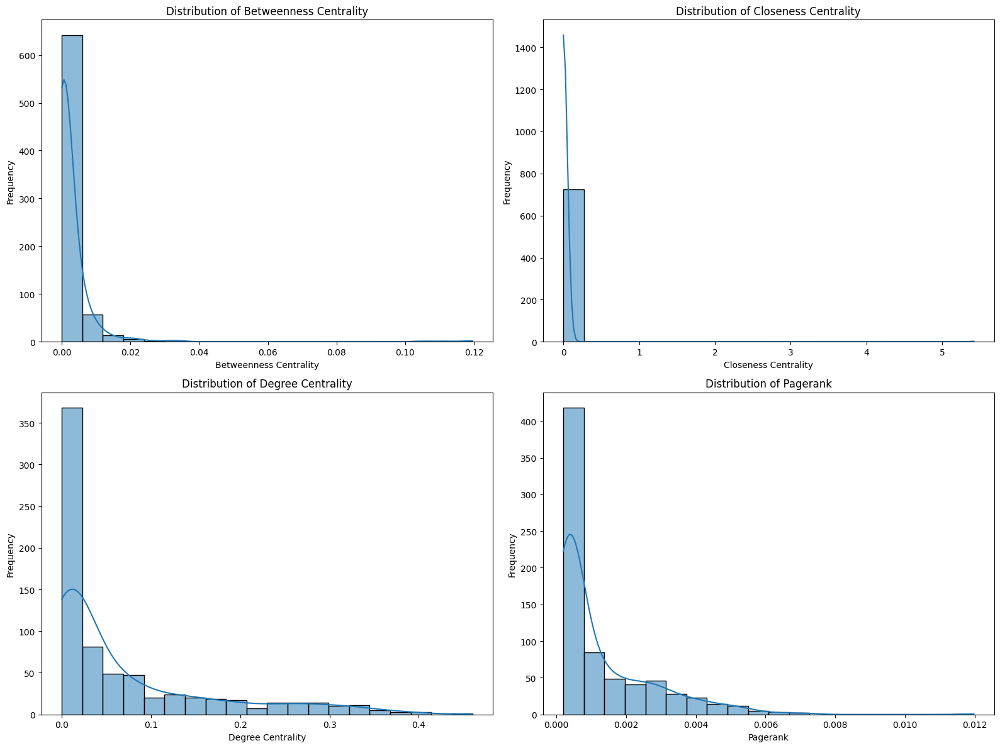

{'betweenness_centrality': [{'index': 'MTN',
   'betweenness_centrality': 0.1195421297615655},
  {'index': 'WFB', 'betweenness_centrality': 0.11870618409803363},
  {'index': 'YIP', 'betweenness_centrality': 0.11104018238814477},
  {'index': 'KTN', 'betweenness_centrality': 0.1048940818846775},
  {'index': 'MEM', 'betweenness_centrality': 0.03477913935594187}],
 'closeness_centrality': [{'index': 'FVS',
   'closeness_centrality': 5.417910447761194},
  {'index': 'STL', 'closeness_centrality': 0.0011257856076218476},
  {'index': 'CMI', 'closeness_centrality': 0.001124608478246726},
  {'index': 'DEC', 'closeness_centrality': 0.001122830894862198},
  {'index': 'SPI', 'closeness_centrality': 0.0011222182204339553}],
 'degree_centrality': [{'index': 'YIP',
   'degree_centrality': 0.46005509641873277},
  {'index': 'MSP', 'degree_centrality': 0.4022038567493113},
  {'index': 'MEM', 'degree_centrality': 0.3953168044077135},
  {'index': 'ORD', 'degree_centrality': 0.3939393939393939},
  {'index':

In [9]:
flightnetwork.compare_centralities()

Let's plot the centrality of the top5

In [13]:
def plot_centrality(metric_name, metric_data):
    labels = [entry['index'] for entry in metric_data]
    values = [entry[metric_name] for entry in metric_data]

    plt.figure(figsize=(10, 5))
    plt.bar(labels, values, color='skyblue')
    plt.xlabel('Index')
    plt.ylabel(metric_name.replace('_', ' ').capitalize())
    plt.title(f'{metric_name.replace("_", " ").capitalize()}')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


First we have to filter to get only the top 5

In [14]:
top_airports = {}
for measure in flightnetwork.centrality_measure.columns:
    top_airports[measure] = (
        flightnetwork.centrality_measure[measure]
        .sort_values(ascending=False)
        .head(5)
        .reset_index()
        .to_dict(orient="records")
    )

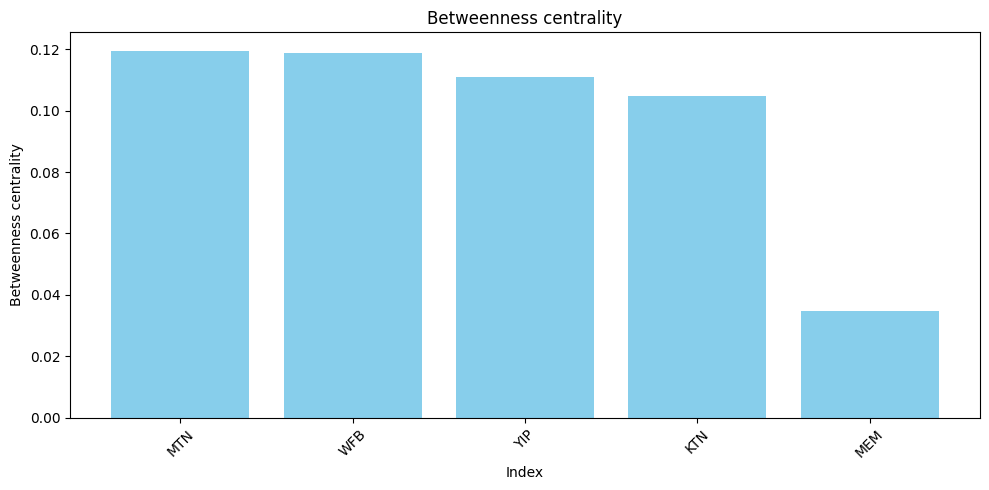

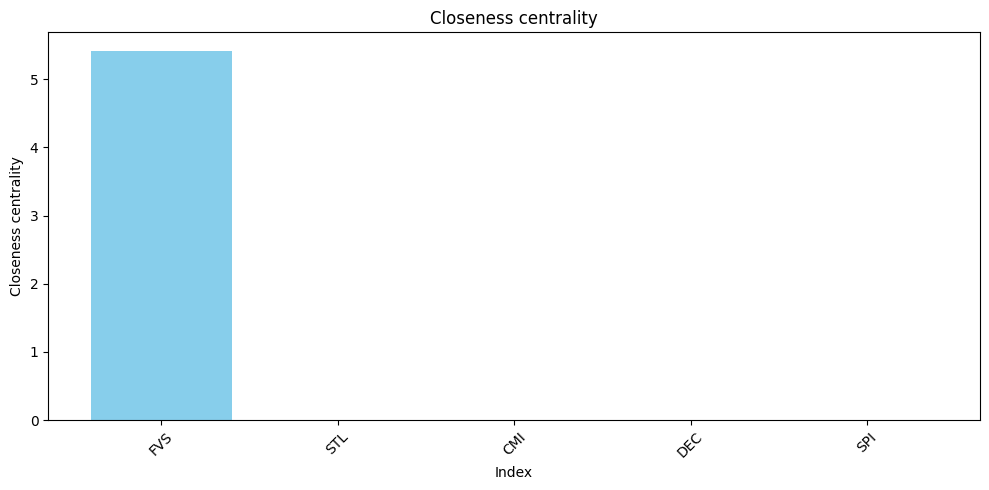

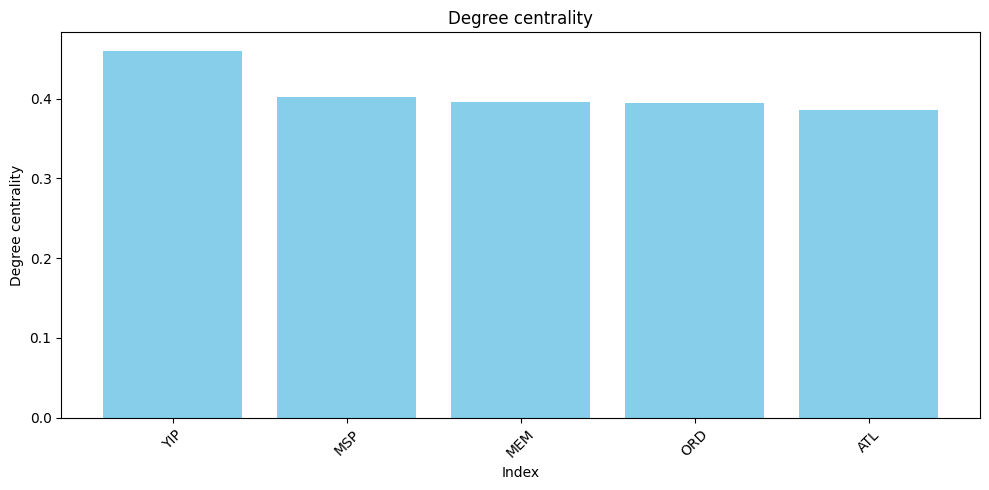

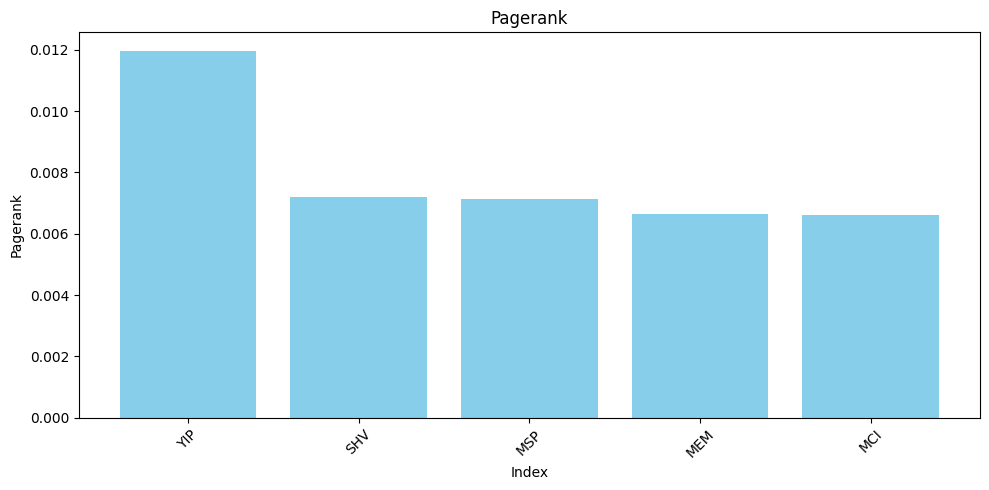

In [15]:
for metric, metric_data in top_airports.items():
    plot_centrality(metric, metric_data)

# 3. Finding Best Routes (Q3)

## Task: Finding the Best Flight Routes

### Problem Statement

When planning to fly to a specific city, the goal is to find the **most efficient and fastest flight** that minimizes the **total distance flown**. 

The focus is on flights operating on a **specific day**.

#### Key Considerations:
- Each city may have **multiple airports**.  
- The function should compute the **best route** for every possible pair of airports between the two cities.

For example, if city **A** has airports \( a_1, a_2 \) and city **B** has airports \( b_1, b_2 \), the function should calculate the best routes for:
-  `a₁ → b₁`
-  `a₁ → b₂`
-  `a₂ → b₁`
-  `a₂ → b₂`

If no valid route exists for a given pair, it should be reported as **"No route found"**.

---

### Function Inputs:
1. **Flights network**: A graph representation of the flight data (airports and distances).
2. **Origin city name**: The starting city.
3. **Destination city name**: The target city.
4. **Considered Date**: The specific date for which flights are being analyzed, in `yyyy-mm-dd` format.

---

### Function Output:
A table with the following three columns:
1. **`Origin_city_airport`**: The code of the origin airport.
2. **`Destination_city_airport`**: The code of the destination airport.
3. **`Best_route`**: A list of airport names showing the order of travel in the optimal route.  
   - The route should minimize the total distance flown.  
   - If no valid route exists, the entry should display **"No route found"**.

____



In [16]:
from auxiliary_files.flight_network import FlightNetwork
import pandas as pd
import heapq
flightnetwork = FlightNetwork()
df = "archive_usa_airport/Airports2.csv"
data = "2001-01-01"  
origin_city = "New York, NY"
destination_city = "Chicago, IL"

results = flightnetwork.find_best_routes( df, data, origin_city, destination_city)
results

,Origin_city_airport,Destination_city_airport,Best_route,Distance
4,LGA,MDW,LGA → CLE → SBN → MDW,724
1,JFK,MDW,JFK → CLE → SBN → MDW,731
3,LGA,ORD,LGA → ORD,733
0,JFK,ORD,JFK → ORD,740
5,LGA,DPA,LGA → EWR → YIP → DPA,757


# RQ4: Airline Network Partitioning

In [1]:
import importlib
from auxiliary_files import flight_network
importlib.reload(flight_network)
from auxiliary_files.flight_network import FlightNetwork
import plotly.graph_objects as go


Let's start defining some useful functions that we will need later: this one (`plot_graph`) is needed to plot the flight network starting from the dataframe. It also contains a legend already prepared to distinguish partitions.

In [3]:
def plot_graph(df_final, partitions=None):
    def remove_bidirectional_duplicates(data):
        seen = set()
        unique_routes = []
        for _, row in data.iterrows():
            route = tuple(sorted([row['Origin_airport'], row['Destination_airport']]))
            if route not in seen:
                seen.add(route)
                unique_routes.append(row)
        return pd.DataFrame(unique_routes)

    df_final = remove_bidirectional_duplicates(df_final)

    fig = go.Figure()

    fig.add_trace(
        go.Scattergeo(
            lon=df_final['Org_airport_long'],
            lat=df_final['Org_airport_lat'],
            mode='markers',
            marker=dict(
                size=3,
                color='blue',
                sizemode='diameter'
            ),
            name='Airports (Origin and Destination)'
        )
    )

    fig.add_trace(
        go.Scattergeo(
            lon=df_final['Dest_airport_long'],
            lat=df_final['Dest_airport_lat'],
            mode='markers',
            marker=dict(
                size=3,
                color='blue',
                sizemode='diameter'
            ),
            showlegend=False  # We don't need it another time: right now we are not interested in identifying origin and destination on the map
        )
    )

    # Lines with color and opacity depending on partitions
    shown_legend = {"orange": False, "black": False, "red": False}

    for idx, row in df_final.iterrows():
        origin = row['Origin_airport']
        destination = row['Destination_airport']

        if partitions is not None:
            # Color based on partitions: orange - black if the graph is bipartite
            part1, part2 = partitions
            if origin in part1 and destination in part1:
                edge_color = "orange"
                fixed_opacity = 0.2
                legend_group = "Flights of partition 1"
            else:
                edge_color = "black"
                fixed_opacity = 1
                legend_group = "Flights of partition 2"
        else:
            # All red if there aren't partitions
            edge_color = "red"
            fixed_opacity = 0.2
            legend_group = "Flights of the flight network"

        fig.add_trace(
            go.Scattergeo(
                lon=[row['Org_airport_long'], row['Dest_airport_long']],
                lat=[row['Org_airport_lat'], row['Dest_airport_lat']],
                mode='lines',
                line=dict(width=0.2, color=edge_color),
                opacity=fixed_opacity,
                name=legend_group if not shown_legend[edge_color] else None,
                showlegend=not shown_legend[edge_color]  # Shows the legend only for the 1st element
            )
        )
        shown_legend[edge_color] = True 

    # Title and legend
    if partitions is not None:
        title_text = 'Graph of USA flights after disconnection (partitioned)'
    else:
        title_text = 'Graph of original USA flights (before disconnection)'

    fig.update_layout(
        title_text=title_text,
        showlegend=True,
        geo=dict(
            scope='usa',
            showland=True,
            landcolor='rgb(0, 210, 0)',
            projection_type='albers usa',
            coastlinecolor="Black",
            showcoastlines=True
        ),
        legend=dict(
            title=dict(
                text="Legend:<br>",
                font=dict(size=12)
            ),
            itemsizing='constant'
        )
    )

    return fig

The function `update_dataset_after_min_cut` aims to update the dataset after the use of the `min_cut` module in the `FlightNetwork` Class: cut edges will be removed from the original dataset.

In [7]:
#Function to update the original dataset deleting the removed edges of min cut

def update_dataset_after_min_cut(dataset: pd.DataFrame, removed_edges: List[Tuple[str, str]]) -> pd.DataFrame:
    """
    Remove edges from the dataset based on the list of removed edges.


    Args:
        dataset (pd.DataFrame): Original dataset with 'source' and 'destination' columns.
        removed_edges (List[Tuple[str, str]]): List of edges removed by the min-cut algorithm.

        Returns:
            pd.DataFrame: Updated dataset without the removed edges.
        """
    # Convert removed_edges to a set for faster lookup
    removed_edges_set = set(removed_edges)

    # Filter out rows corresponding to removed edges
    updated_dataset = dataset[~dataset[['Origin_airport', 'Destination_airport']].apply(tuple, axis=1).isin(removed_edges_set)]

    return updated_dataset

Here is defined the main function for this task: `graph_disconnection` takes as input the flight network and its objective is to divide it into two distinct partitions, p1 and p2, such that no flights connect any airport in p1 to any airport in p2 using the `min_cut` module. The output will include:
- the list of removed flights;
- the tuple containing the airports belonging to the two partitions;
- the visual representation of the original graph 
- the visual representation of the partitioned graph, highlighting the two resulting subgraphs.


In [8]:
#Final function of RQ4: 
def graph_disconnection(Flight_Network):

    removed_edges, Partitions = Flight_Network.min_cut(source = 'FFO', sink = 'ZXX')
    # Here we decided source and sink nodes before starting, but it is clear that if given two airports only one edge is needed to disconnect them one to each other,
    # then the entire network will consequently be disconnected.

    print("Flights removed to disconnect the graph:", removed_edges)
    print("Partitions:", Partitions)

    graph1 = plot_graph(df_final)
    graph1.show()

    df_final_upd = update_dataset_after_min_cut(df_final, removed_edges)

    graph2 = plot_graph(df_final_upd,partitions=Partitions)
    graph2.show()

Finally we create the flight network and apply `graph_disconnection` to it.

In [9]:
#creation of the network based on the dataset
flight_network = FlightNetwork()
df_final = pd.read_csv('archive_usa_airport/flights_final.csv')
origin_airports = df_final["Origin_airport"]
destination_airports = df_final["Destination_airport"]
dists=df_final["Distance"]

# Add nodes and edges using the new function
flight_network.add_nodes_and_edges2(origin_airports, destination_airports)

#Apply graph_disconnection
graph_disconnection(flight_network)

Flights removed to disconnect the graph: [('GEG', 'ZXX')]
Partitions: ({'LEW', 'SLE', 'FLL', 'MOB', 'MDT', 'BAD', 'UCA', 'LKE', 'MEM', 'NFL', 'PKB', 'LAW', 'RAC', 'TUP', 'AMW', 'SAC', 'CRS', 'STF', 'GMU', 'PRZ', 'IMT', 'APC', 'MI2', 'HUA', 'NZC', 'BOK', 'WBR', 'FOE', 'SJC', 'ASL', 'VCT', 'BNA', 'MPS', 'AXV', 'SGU', 'CGI', 'BMI', 'NJK', 'CMI', 'GAD', 'END', 'HKS', 'MML', 'SUM', 'BFD', 'FTY', 'HFD', 'SFF', 'WDG', 'MYF', 'BDR', 'SER', 'AOH', 'MS1', 'TYR', 'CYS', 'HSH', 'CRE', 'TBR', 'UIN', 'POU', 'HGR', 'SNS', 'PDT', 'NC3', 'GSO', 'SKY', 'UCY', 'MYR', 'FBK', 'ITO', 'CNW', 'RDU', 'GUP', 'MKT', 'LGU', 'CPR', 'FFT', 'ABR', 'MCW', 'PBG', 'TUL', 'DSM', 'ADM', 'AUG', 'AZA', 'TLH', 'SBM', 'LAF', 'TIW', 'GSP', 'TTN', 'ORL', 'TMB', 'JST', 'BHM', 'UXJ', 'BUF', 'SAT', 'ARB', 'MIB', 'OLU', 'ELN', 'HII', 'RFD', 'EIL', 'FWA', 'SGF', 'ESN', 'SBN', 'FYV', 'MEJ', 'OWB', 'AMA', 'FMN', 'LWF', 'BRO', 'XWL', 'PUW', 'CPS', 'LSF', 'SEM', 'SLN', 'SAD', 'TSM', 'DOV', 'CEV', 'TWF', 'IRK', 'LJY', 'GTR', 'DVT', 'PDK

The result that we obtained highlights that only one edge cut is needed to split the flight network into two partitions.
It is important to underline that this is not the only best solution to this minimum cut problem: lots of solutions gave back a single cut to get the aimed result; anyway we chose this one because it allows to have the smaller partition still made by an interesting number of nodes (20), so that this one has an effective meaning. 

# 5. Finding and Extracting Communities (Q5)

Airlines can optimize their operations by identifying communities within a flight network. These communities represent groups of airports with strong connections, helping airlines pinpoint high-demand regions for expansion or underserved areas for consolidation. By analyzing these communities, airlines can improve resource allocation, reduce costs, and enhance service quality.

In this task, you are asked to analyze the graph and identify the communities based on the flight network provided. For the airline, the primary focus is on the cities, so your communities should reflect the connectivity between cities through the flights that link them.


In [ ]:
import networkx as nx
import pandas as pd
from auxiliary_files.flight_network import FlightNetwork
import heapq
df_final = pd.read_csv("archive_usa_airport/Airports2.csv")

flightnetwork = FlightNetwork()

origin_airports = df_final['Origin_city']
destination_airports = df_final['Destination_city']
distances = df_final["Distance"]

flightnetwork.add_nodes_and_edges(origin_airports, destination_airports, distances)

print("Numero di nodi:", flightnetwork.graph.number_of_nodes())
print("Numero di archi:", flightnetwork.graph.number_of_edges())

In [ ]:
import networkx as nx
from collections import defaultdict
import random
import time

def compute_modularity(graph, communities, m):
    Q = 0.0
    for u, v, data in graph.edges(data=True):
        weight = data.get("weight", 1.0)
        if communities[u] == communities[v]:
            ki = sum(data.get("weight", 1.0) for _, _, data in graph.edges(u, data=True))
            kj = sum(data.get("weight", 1.0) for _, _, data in graph.edges(v, data=True))
            Q += weight - (ki * kj) / (2 * m)
    return Q / (2 * m)

def louvain_with_max_iterations(graph, max_iterations=300):

    communities = {node: i for i, node in enumerate(graph.nodes())}
    m = sum(data.get("weight", 1.0) for _, _, data in graph.edges(data=True)) / 2 

    print(f"Numero totale di nodi: {len(graph.nodes())}, Peso totale del grafo (2m): {2 * m}")

    improvement = True
    iteration = 0
    modularity_history = []  

    while iteration < max_iterations:
        iteration += 1
        improvement = False
        nodes = list(graph.nodes())
        random.shuffle(nodes)  

        print(f"\nInizio iterazione {iteration} - Numero di nodi: {len(nodes)}")

        for node in nodes:
            best_community = communities[node]
            best_increase = 0
            current_community = communities[node]

            neighbor_communities = defaultdict(float)
            for neighbor in graph.neighbors(node):
                weight = graph[node][neighbor].get("weight", 1.0)
                neighbor_communities[communities[neighbor]] += weight

            for community, weight_sum in neighbor_communities.items():
                ki = sum(data.get("weight", 1.0) for _, _, data in graph.edges(node, data=True))
                sigma_tot = sum(
                    sum(data.get("weight", 1.0) for _, _, data in graph.edges(n, data=True))
                    for n in graph.nodes()
                    if communities[n] == community
                )
                delta_Q = (weight_sum - (ki * sigma_tot) / (2 * m))

                if delta_Q > best_increase:
                    best_community = community
                    best_increase = delta_Q

            if best_community != current_community:
                communities[node] = best_community
                improvement = True

        current_modularity = compute_modularity(graph, communities, m)
        modularity_history.append(current_modularity)

        print(f"Iterazione {iteration} - Modularità: {current_modularity:.6f}")
        print(f"Tempo trascorso finora: {time.time() - start_time:.2f} secondi")

    print(f"\nNumero massimo di iterazioni ({max_iterations}) raggiunto.")
    print("Algoritmo terminato.")

    community_groups = defaultdict(list)
    for node, community in communities.items():
        community_groups[community].append(node)

    return list(community_groups.values())

start_time = time.time()
communities = louvain_with_max_iterations(flightnetwork.graph, max_iterations=30)
end_time = time.time()

print(f"Numero di comunità rilevate: {len(communities)}")
for i, community in enumerate(communities):
    print(f"Comunità {i+1}: {community}")
print(f"Tempo totale di esecuzione: {end_time - start_time:.2f} secondi")


In [ ]:
import folium
import random
from matplotlib.colors import rgb2hex
import matplotlib.pyplot as plt


def visualize_communities_on_map(graph, communities, airport_data):
    """
    Visualizza le comunità su una mappa interattiva con Folium.
    
    Args:
        graph: Il grafo contenente gli aeroporti.
        communities: Lista delle comunità (ogni comunità è una lista di nodi).
        airport_data: DataFrame con informazioni sugli aeroporti, incluse latitudine e longitudine.
    """

    map_center = [39.8283, -98.5795]  
    folium_map = folium.Map(location=map_center, zoom_start=5)
    import random

    community_colors = ['#%02X%02X%02X' % (random.randint(0, 255), random.randint(0, 255), random.randint(0, 255)) for c in range(len(communities))]
    for idx, community in enumerate(communities):
        color = community_colors[idx]
        for airport in community:
            row = airport_data[airport_data['City'] == airport]
            try:
                lat = row.iloc[0]['Airport_lat']
                lon = row.iloc[0]['Airport_long']
                folium.CircleMarker(
                    location=(lat, lon),
                    radius=5,
                    color=color,
                    fill=True,
                    fill_opacity=0.7,
                    tooltip=f"Airport: {airport} (Community {idx})"
                ).add_to(folium_map)
            except:
                continue

    return folium_map

import pandas as pd

def take_one_airport(group):
    return group.sample(n=1)


city = pd.read_csv("archive_usa_aiport/Airports2.csv")
destinations = city[['Destination_city', 'Destination_airport', 'Dest_airport_lat', 'Dest_airport_long']]
origins = city[['Origin_city', 'Origin_airport', 'Org_airport_lat', 'Org_airport_long']] 

destinations.columns = ['City', 'Airport', 'Airport_lat', 'Airport_long']
origins.columns = ['City', 'Airport', 'Airport_lat', 'Airport_long']

combined_cities = pd.concat([origins, destinations], axis=0, ignore_index=True)

city_coordinates = combined_cities.groupby("City").apply(take_one_airport).reset_index(drop=True)

map_communities = visualize_communities_on_map(flightnetwork.graph, communities, city_coordinates)
map_communities.save("communities_map.html")  
map_communities


### Function Inputs and Outputs

#### Inputs:
1. **Flight Network**: The network of flights represented as a graph.
2. **City 1 `c1`**: The origin city.
3. **City 2 `c2`**: The destination city.

#### Outputs:
1. **Total Number of Communities**: 
   - The function calculates and displays the total number of communities detected in the flight network.
2. **Cities in Each Community**:
   - The function lists the cities belonging to each community.
3. **Graph Visualization**:
   - A visualization of the flight network graph highlighting the communities, where each community is represented in a different color.
4. **Community Check for `c1` and `c2`**:
   - The function checks if the two input cities (`c1` and `c2`) belong to the same community and returns the result.


In [ ]:
import matplotlib.pyplot as plt
from matplotlib.colors import rgb2hex

def same_community(city1, city2, communities):
    for community in communities:
        if city1 in community and city2 in community:
            return True
    return False

def visualize_communities(graph, communities):
    pos = nx.spring_layout(graph)  
    cmap = plt.get_cmap('tab10')
    node_colors = {}
    for idx, community in enumerate(communities):
        color = rgb2hex(cmap(idx / len(communities))[:3])
        for node in community:
            node_colors[node] = color

    nx.draw_networkx_nodes(
        graph, pos, 
        node_color=[node_colors[node] for node in graph.nodes()], 
        node_size=300, 
        alpha=0.8
    )
    nx.draw_networkx_edges(graph, pos, alpha=0.5)
    nx.draw_networkx_labels(graph, pos, font_size=8)

    plt.title("Communities in the Flight Network")
    plt.axis("off")
    plt.show()
def analyze_flight_network(graph, communities, city1, city2):

    total_communities = len(communities)
    community_dict = {f"Community {i+1}": list(community) for i, community in enumerate(communities)}
    same_community_flag = same_community(city1, city2, communities)
    visualize_communities(graph, communities)
    print(f"Total number of communities: {total_communities}")
    for community_name, cities in community_dict.items():
        print(f"{community_name}: {cities}")

    print(f"The airpors {city1} and {city2} are in the same community: {same_community_flag}")


analyze_flight_network(flightnetwork.graph, communities, "SVC", "NZJ")


In [ ]:
import networkx as nx
from collections import Counter, defaultdict
import random
import time

def label_propagation(graph, max_iterations=100):
    """
    Algoritmo di Label Propagation per la rilevazione delle comunità.
    
    Args:
        graph (nx.Graph): Grafo di input.
        max_iterations (int): Numero massimo di iterazioni.
    
    Returns:
        List[List[str]]: Liste di nodi raggruppati per comunità.
    """

    labels = {node: node for node in graph.nodes()}
    iteration = 0

    while iteration < max_iterations:
        iteration += 1
        changes = 0
        
        nodes = list(graph.nodes())
        random.shuffle(nodes)

        for node in nodes:
            neighbor_labels = [labels[neighbor] for neighbor in graph.neighbors(node)]
            if not neighbor_labels:
                continue
            most_common_label = Counter(neighbor_labels).most_common(1)[0][0]
            
            if labels[node] != most_common_label:
                labels[node] = most_common_label
                changes += 1

        if changes == 0:
            print(f"Convergency found at the iteration: {iteration}.")
            break
    
    communities = defaultdict(list)
    for node, label in labels.items():
        communities[label].append(node)
    
    return list(communities.values())

start_time = time.time()
communities_chat = label_propagation(flightnetwork.graph, max_iterations=300)
end_time = time.time()

print(f"Number of communities found: {len(communities_chat)}")
for i, community in enumerate(communities_chat):
    print(f"Community {i+1}: {community}")
print(f"Total execution time: {end_time - start_time:.2f} seconds")


### Key Differences Between Louvain and Label Propagation

| **Feature**             | **Louvain Algorithm**                       | **Label Propagation Algorithm**           |
|--------------------------|---------------------------------------------|-------------------------------------------|
| **Speed**                | Slower, especially for large graphs.        | Extremely fast and scalable.              |
| **Determinism**          | Deterministic for the same input.           | Non-deterministic due to random initialization. |
| **Output Structure**     | Identifies hierarchical communities.        | Flat communities, no hierarchy.           |
| **Optimization Metric**  | Maximizes modularity.                       | No explicit optimization metric.          |
| **Use Case**             | Ideal for modular and hierarchical graphs.  | Suitable for large or dynamic networks.   |
| **Accuracy**             | High for modularity-based graphs.           | Moderate, depends on graph structure.     |

**Summary**: Louvain is best for accurate and modularity-focused tasks, while Label Propagation is better for fast, approximate solutions in large or dynamic networks.


it seems that the Louvain algorithm performs better than Label Propagation because the second one finds only one community

## <strong> Bonus Question - Connected Components on MapReduce

MapReduce is ideal for network analysis as it enables parallel processing of large graph datasets, making it scalable and efficient. By breaking tasks into map and reduce steps, it allows for distributed analysis of networks, which is essential for handling large-scale graph problems like connected components.

    In this task, you are required to use PySpark and the MapReduce paradigm to identify the connected components in a flight network graph. The focus should be on airports rather than cities. As you know, a connected component refers to a group of airports where every pair of airports within the group is connected either directly or indirectly.

The function takes the following inputs:

    Flight network
    A starting date
    An end date

The function outputs:

    The number of the connected components during that period
    The size of each connectd componenet
    The airports within the largest connected component identified.


In [1]:
from auxiliary_files.ConnectedComponents import *
csv = 'archive_usa_airport/flights_final.csv'

# DATES must be in the format YYYY-MM-DD between 1990 and 2009
start_date = '1990-01-01'
end_date = '2005-12-31'

connections = find_connected_components(csv, start_date,end_date) 

Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).
24/12/23 22:02:48 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable


Total nodes:  663
Total edges:  29077


In [2]:
connections

(11,
 [570, 49, 10, 26, 1, 2, 1, 1, 1, 1, 1],
 ['CGI',
  'LRD',
  'MCO',
  'BIS',
  'MGW',
  'CKB',
  'EWR',
  'STL',
  'ELP',
  'LBB',
  'PIT',
  'OGG',
  'CVG',
  'RDU',
  'CRW',
  'GSP',
  'SBY',
  'BUF',
  'SCE',
  'PUB',
  'OGD',
  'RFD',
  'GPT',
  'ILM',
  'JFK',
  'BHM',
  'TCL',
  'SAN',
  'MHK',
  'LSF',
  'YIP',
  'RAP',
  'CLE',
  'SBA',
  'CMI',
  'LCH',
  'SUX',
  'SEA',
  'BGR',
  'RIC',
  'ILN',
  'ADS',
  'GRR',
  'BOS',
  'TUS',
  'RCA',
  'DSM',
  'ATL',
  'DET',
  'SFO',
  'MSN',
  'SMF',
  'MDW',
  'LFT',
  'RWI',
  'SLC',
  'PUW',
  'GEG',
  'TCM',
  'COS',
  'BMG',
  'LCK',
  'CMH',
  'BNA',
  'BDL',
  'TVC',
  'LAS',
  'BZN',
  'FWA',
  'CAE',
  'LNK',
  'SAT',
  'SLN',
  'IAH',
  'OAK',
  'PNS',
  'JRB',
  'YNG',
  'BGM',
  'LGA',
  'PIA',
  'ORD',
  'DTW',
  'ORH',
  'CLL',
  'FOE',
  'DLH',
  'TUL',
  'IAD',
  'ANC',
  'CLT',
  'MCI',
  'BTL',
  'MWH',
  'PDX',
  'EIL',
  'TYS',
  'ILG',
  'OMA',
  'TOL',
  'SAV',
  'RNO',
  'RDG',
  'ISO',
  'SHV',
  'ABI',


## GraphFrames implementation

In [ ]:
from graphframes import GraphFrame

In [ ]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import col
from graphframes import GraphFrame
import time

def find_connected_connections_graph(csv_path: str, start_date: str, end_date: str) -> dict:


    # Initialize the Spark session
    spark = SparkSession.builder \
        .appName("GraphFramesExample") \
        .config("spark.jars.packages", "graphframes:graphframes:0.8.2-spark3.1-s_2.12") \
        .getOrCreate()

    # Set checkpoint directory for GraphFrames
    spark.sparkContext.setCheckpointDir("/tmp/checkpoints")

    print(f"Analyzing flight network from {start_date} to {end_date}")

    # Load and filter flight network data
    print("Loading and filtering flight network data...")
    df = spark.read.csv(csv_path, header=True, inferSchema=True)

    # Convert "Fly_date" column to date and apply the date range filter
    df = df.withColumn("Fly_date", col("Fly_date").cast("date"))
    df = df.filter((col("Fly_date") >= start_date) & (col("Fly_date") <= end_date))
    df = df.select("Origin_airport", "Destination_airport", "Fly_date")

    # Create a DataFrame of unique airports (vertices)
    unique_airports = df.select("Origin_airport").distinct().union(df.select("Destination_airport").distinct()).distinct()
    vertices = unique_airports.withColumnRenamed("Origin_airport", "id")

    # Create edges DataFrame with source (src) and destination (dst)
    edges = df.withColumnRenamed("Origin_airport", "src").withColumnRenamed("Destination_airport", "dst")

    # Create GraphFrame
    g = GraphFrame(vertices, edges)

    # Finding connected components
    print("Finding connected components...")
    result = g.connectedComponents()

    # Calculate component sizes
    component_sizes = result.groupBy("component").count().collect()
    sizes = [row["count"] for row in component_sizes]

    # Find the largest component
    largest_component_id = max(component_sizes, key=lambda x: x["count"])["component"]
    largest_component = result.filter(result.component == largest_component_id).select("id").rdd.map(lambda x: x[0]).collect()


    final_result = {
        'number_of_components': len(component_sizes),
        'component_sizes': sizes,
        'largest_component_size': max(sizes),

    }

    # Stop the Spark session
    spark.stop()

    return final_result

def process_in_parallel(csv_path: str, start_date: str, end_date: str, num_partitions: int = None):
    """
    Wrapper function to handle the parallel processing with configurable partitions
    """
    try:
        # Initialize the Spark session and configure it (no need for SparkContext directly)
        spark = SparkSession.builder \
            .appName("ParallelConnectedComponents") \
            .config("spark.jars.packages", "graphframes:graphframes:0.8.2-spark3.1-s_2.12") \
            .getOrCreate()

        if num_partitions:
            spark.conf.set("spark.default.parallelism", str(num_partitions))

        # Run the analysis using the graph-based method
        result = find_connected_connections_graph(csv_path, start_date, end_date)

        return result

    except Exception as e:
        print(f"Error in parallel processing: {str(e)}")
        raise
    finally:
        # Stop the Spark session
        spark.stop()


## Execution Time comparison


The temporal analysis highlighted significant performance differences between the RDD-based implementation and the GraphFrames implementation for identifying connected components in a flight graph. The RDD approach proved to be considerably faster, with a total time of  91.73 seconds compared to 316.58 seconds for GraphFrames, showing an advantage of 224.85 seconds

This result seems to be justified by various factors: 
- the **`setup_time`** of RDD (without GraphFrames) was **extremely faster**, the data loading took **9.36 seconds less**

- the **``processing_time`** itself with the Union-Find algorithm was more efficient algorithm used by GraphFrames, saving 85.88 seconds.Maybe this is due to the iterative nature of the **connected components** algorithm used by GraphFrames. Initially, each vertex is assigned a unique component ID.Each vertex must repeatedly propagate its component ID to neighbors, updating to the lowest ID found. This process may require many iterations to achieve convergence. 

- Additionally, the **`component_analysis`** with RDD showed a significantly reduced time, with an advantage of **93.30  seconds** over GraphFrames.

- Overall, the RDD implementation confirmed greater optimization.


GraphFrames. "GraphFrame.connectedComponents." GraphFrames Documentation, n.d., https://graphframes.github.io/graphframes/docs/_site/api/python/graphframes.html#graphframes.GraphFrame.connectedComponents. Accessed 23 Dec. 2024.

In [ ]:
import time
from typing import Dict, Any
from dataclasses import dataclass
from pyspark.sql import SparkSession
from pyspark.sql.functions import col
from graphframes import GraphFrame

@dataclass
class TimingMetrics:
    setup_time: float = 0
    data_loading_time: float = 0
    processing_time: float = 0
    component_analysis_time: float = 0
    total_time: float = 0

def measure_time(func):
    def wrapper(*args, **kwargs):
        start_time = time.time()
        result = func(*args, **kwargs)
        end_time = time.time()
        return result, end_time - start_time
    return wrapper

def find_connected_connections_with_timing(csv_path: str, start_date: str, end_date: str) -> Dict[str, Any]:
    metrics = TimingMetrics()
    total_start = time.time()

    # Setup timing
    setup_start = time.time()
    spark = SparkSession.builder.appName("ConnectedComponents").getOrCreate()
    metrics.setup_time = time.time() - setup_start

    # Data loading timing
    loading_start = time.time()
    df = spark.read.csv(csv_path, header=True)
    df = df.filter((df.Fly_date >= start_date) & (df.Fly_date <= end_date))
    df = df.select("Origin_airport", "Destination_airport", "Fly_date")
    metrics.data_loading_time = time.time() - loading_start

    # Processing timing
    processing_start = time.time()

    def emit_bidirectional_edges(row):
        origin = row.Origin_airport
        dest = row.Destination_airport
        return [(origin, dest), (dest, origin)]


    edges_rdd = df.rdd.flatMap(emit_bidirectional_edges).distinct()


    def update_components(edges):
        components = {}

        def find(node):
            if node not in components:
                components[node] = node
            if components[node] != node:
                components[node] = find(components[node])
            return components[node]

        def union(node1, node2):
            root1, root2 = find(node1), find(node2)
            if root1 != root2:
                components[root2] = root1


        for origin, dest in edges:
            union(origin, dest)


        return [(node, find(node)) for node in components.keys()]


    components_rdd = edges_rdd.mapPartitions(lambda x: update_components(x))


    prev_components = None
    curr_components = components_rdd.collectAsMap()

    iteration = 1
    while prev_components != curr_components and iteration <= 10:
        print(f"Iteration {iteration}")
        prev_components = curr_components
        components_rdd = edges_rdd.map(
            lambda edge: (edge[1], curr_components.get(edge[0]))
        ).filter(
            lambda x: x[1] is not None
        ).reduceByKey(
            lambda x, y: min(x, y)
        )

        curr_components = components_rdd.collectAsMap()
        iteration += 1


    if prev_components == curr_components:
        print(f"Converged at iteration {iteration - 1}")
    else:
        print("Reached maximum iterations without convergence.")



    metrics.processing_time = time.time() - processing_start

    # Component analysis timing
    analysis_start = time.time()
    final_components_df = spark.createDataFrame(
        components_rdd.map(lambda x: (x[0], x[1])).collect(),
        ["node", "component_id"]
    )

    component_sizes = final_components_df.groupBy("component_id").count().collect()
    sizes = [row["count"] for row in component_sizes]

    largest_component_id = max(component_sizes, key=lambda x: x["count"])["component_id"]
    largest_component = final_components_df.filter(
        final_components_df.component_id == largest_component_id
    ).select("node").rdd.map(lambda x: x[0]).collect()
    metrics.component_analysis_time = time.time() - analysis_start

    metrics.total_time = time.time() - total_start

    result = {
        'number_of_components': len(component_sizes),
        'component_sizes': sizes,
        'largest_component_size': max(sizes),
        'timing_metrics': {
            'setup_time': metrics.setup_time,
            'data_loading_time': metrics.data_loading_time,
            'processing_time': metrics.processing_time,
            'component_analysis_time': metrics.component_analysis_time,
            'total_time': metrics.total_time
        }
    }

    spark.stop()
    return result

def find_connected_connections_graph_with_timing(csv_path: str, start_date: str, end_date: str) -> Dict[str, Any]:
    metrics = TimingMetrics()
    total_start = time.time()

    # Setup timing
    setup_start = time.time()
    spark = SparkSession.builder \
        .appName("GraphFramesExample") \
        .config("spark.jars.packages", "graphframes:graphframes:0.8.2-spark3.1-s_2.12") \
        .getOrCreate()
    spark.sparkContext.setCheckpointDir("/tmp/checkpoints")
    metrics.setup_time = time.time() - setup_start

    # Data loading timing
    loading_start = time.time()
    df = spark.read.csv(csv_path, header=True, inferSchema=True)
    df = df.withColumn("Fly_date", col("Fly_date").cast("date"))
    df = df.filter((col("Fly_date") >= start_date) & (col("Fly_date") <= end_date))
    df = df.select("Origin_airport", "Destination_airport", "Fly_date")
    metrics.data_loading_time = time.time() - loading_start

    # Processing timing
    processing_start = time.time()
    vertices = df.select("Origin_airport").distinct().union(
        df.select("Destination_airport").distinct()
    ).distinct().withColumnRenamed("Origin_airport", "id")

    edges = df.withColumnRenamed("Origin_airport", "src") \
              .withColumnRenamed("Destination_airport", "dst")

    g = GraphFrame(vertices, edges)
    result = g.connectedComponents()
    metrics.processing_time = time.time() - processing_start

    # Component analysis timing
    analysis_start = time.time()
    component_sizes = result.groupBy("component").count().collect()
    sizes = [row["count"] for row in component_sizes]

    largest_component_id = max(component_sizes, key=lambda x: x["count"])["component"]
    largest_component = result.filter(result.component == largest_component_id) \
                            .select("id").rdd.map(lambda x: x[0]).collect()
    metrics.component_analysis_time = time.time() - analysis_start

    metrics.total_time = time.time() - total_start

    final_result = {
        'number_of_components': len(component_sizes),
        'component_sizes': sizes,
        'largest_component_size': max(sizes),
        'timing_metrics': {
            'setup_time': metrics.setup_time,
            'data_loading_time': metrics.data_loading_time,
            'processing_time': metrics.processing_time,
            'component_analysis_time': metrics.component_analysis_time,
            'total_time': metrics.total_time
        }
    }

    spark.stop()
    return final_result

def compare_implementations_with_timing(csv_path: str, start_date: str, end_date: str):
    print("Running Original Implementation...")
    original_result = find_connected_connections_with_timing(csv_path, start_date, end_date)

    print("\nRunning GraphFrames Implementation...")
    graphframes_result = find_connected_connections_graph_with_timing(csv_path, start_date, end_date)

    print("\nTiming Analysis:")
    print("-" * 80)
    print(f"{'Section':<25} {'Original (s)':<15} {'GraphFrames (s)':<15} {'Difference (s)':<15}")
    print("-" * 80)

    sections = ['setup_time', 'data_loading_time', 'processing_time', 'component_analysis_time', 'total_time']

    for section in sections:
        orig_time = original_result['timing_metrics'][section]
        graph_time = graphframes_result['timing_metrics'][section]
        diff = orig_time - graph_time
        print(f"{section:<25} {orig_time:>14.2f} {graph_time:>14.2f} {diff:>14.2f}")

    return original_result, graphframes_result

csv_path = 'archive_usa_airport/flights_final.csv'
start_date = '1990-01-01'
end_date = '2005-12-31'

original_result, graphframes_result = compare_implementations_with_timing(csv_path, start_date, end_date)